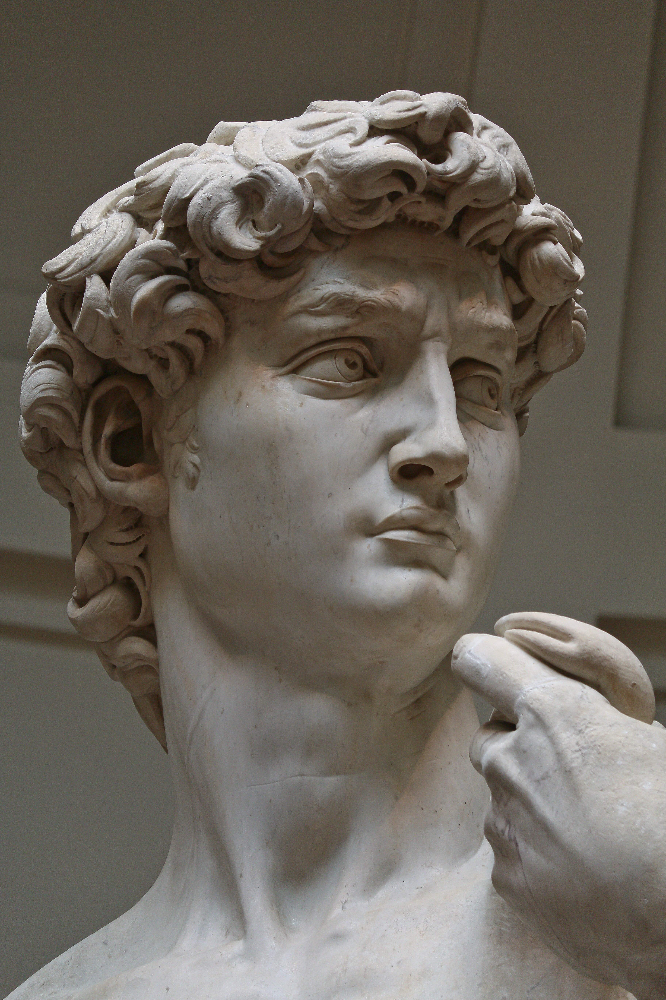

In [48]:
from PIL import Image

image = Image.open("'David'_by_Michelangelo_Fir_JBU013.jpg")

image_copy = image.copy()

image_copy

# result = imgSmall.resize(image.size,Image.NEAREST)

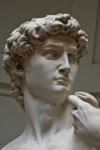

In [50]:
image_copy.thumbnail((150,150))

image_copy

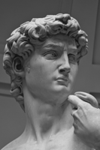

In [51]:
image_gray = image_copy.convert('L').convert('RGB')
image_gray

In [52]:
def set_quant_err(x, y, image, quant, *err):
    width, height = image.size
    index = x + y * width
    pixellist = list(image.getdata())
    red = pixellist[index][0]
    green = pixellist[index][1]
    blue =  pixellist[index][2]
    
    red = int(red + err_r * quant)
    green = int(green + err_g * quant)
    blue =  int(blue + err_b * quant)
    
    rgb = (red, green, blue)
    
    image.putpixel((x, y), rgb)

In [53]:
width, height = image_gray.size

pixellist = list(image_gray.getdata())



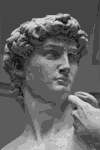

In [57]:
for y in range(0, height-1):
    for x in range(1, width-1):
        index = x + y * width
        curr_pixel = pixellist[index]
        old_r = curr_pixel[0]
        old_g = curr_pixel[1]
        old_b = curr_pixel[2]
        
        factor = 11
        
        new_r = round(factor * old_r/255) * (255/factor)
        new_g = round(factor * old_g/255) * (255/factor)
        new_b = round(factor * old_b/255) * (255/factor)
        
        new_rgb = (int(new_r), int(new_g), int(new_b))
        
        image_gray.putpixel((x, y), new_rgb)
        
        image_gray_copy = image_gray.copy()
        
        err_r = int(old_r - new_r)
        err_g = int(old_g - new_g)
        err_b = int(old_b - new_b)
     
        set_quant_err(x + 1, y, image_gray_copy, 7 / 16, err_r, err_g, err_b)
        set_quant_err(x - 1, y + 1, image_gray_copy, 3 / 16, err_r, err_g, err_b)
        set_quant_err(x, y + 1, image_gray_copy, 5 / 16, err_r, err_g, err_b)
        set_quant_err(x + 1, y + 1, image_gray_copy, 1 / 16, err_r, err_g, err_b)

image_gray
image_gray_copy

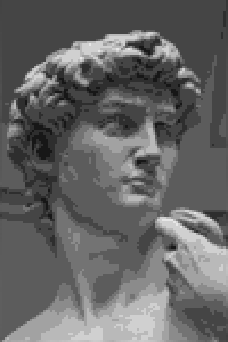

In [59]:
width_origin, height_origin = image.size

image_gray.convert('LA').resize((int(width_origin/16), int(height_origin/16)),Image.NEAREST)
